<a href="https://www.kaggle.com/code/sjagkoo7/supermarket-sales-eda?scriptVersionId=140955924" target="_blank"><img align="left" alt="Kaggle" title="Open in Kaggle" src="https://kaggle.com/static/images/open-in-kaggle.svg"></a>

# Introduction

The growth of supermarkets in most populated cities are increasing and market competitions are also high. The dataset is one of the historical sales of supermarket company which has recorded in 3 different branches for 3 months data. Predictive data analytics methods are easy to apply with this dataset.

`Attribute information :`
* `Invoice id:` Computer generated sales slip invoice identification number
* `Branch:` Branch of supercenter (3 branches are available identified by A, B and C).
* `City:` Location of supercenters
* `Customer type:` Type of customers, recorded by Members for customers using member card and Normal for without member card.
* `Gender:` Gender type of customer
* `Product line:` General item categorization groups - Electronic accessories, Fashion accessories, Food and beverages, Health and beauty, Home and lifestyle, Sports and travel
* `Unit price:` Price of each product in $
* `Quantity:` Number of products purchased by customer
* `Tax:` 5% tax fee for customer buying
* `Total:` Total price including tax
* `Date:` Date of purchase (Record available from January 2019 to March 2019)
* `Time:` Purchase time (10am to 9pm)
* `Payment:` Payment used by customer for purchase (3 methods are available – Cash, Credit card and Ewallet)
* `COGS:` Cost of goods sold
* `Gross margin percentage:` Gross margin percentage
* `Gross income:` Gross income
* `Rating:` Customer stratification rating on their overall shopping experience (On a scale of 1 to 10)

# Importing Libraries

In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import matplotlib.pyplot as plt
import seaborn as sns
import pandas_profiling
import sklearn

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/supermarket-sales/supermarket_sales - Sheet1.csv


# Reading the Dataset

In [2]:
sales=pd.read_csv("/kaggle/input/supermarket-sales/supermarket_sales - Sheet1.csv")
sales.head()

,Invoice ID,Branch,City,Customer type,Gender,Product line,Unit price,Quantity,Tax 5%,Total,Date,Time,Payment,cogs,gross margin percentage,gross income,Rating
0,750-67-8428,A,Yangon,Member,Female,Health and beauty,74.69,7,26.1415,548.9715,1/5/2019,13:08,Ewallet,522.83,4.761905,26.1415,9.1
1,226-31-3081,C,Naypyitaw,Normal,Female,Electronic accessories,15.28,5,3.8200,80.2200,3/8/2019,10:29,Cash,76.40,4.761905,3.8200,9.6
2,631-41-3108,A,Yangon,Normal,Male,Home and lifestyle,46.33,7,16.2155,340.5255,3/3/2019,13:23,Credit card,324.31,4.761905,16.2155,7.4
3,123-19-1176,A,Yangon,Member,Male,Health and beauty,58.22,8,23.2880,489.0480,1/27/2019,20:33,Ewallet,465.76,4.761905,23.2880,8.4
4,373-73-7910,A,Yangon,Normal,Male,Sports and travel,86.31,7,30.2085,634.3785,2/8/2019,10:37,Ewallet,604.17,4.761905,30.2085,5.3


# Data Pre-processing

In [3]:
sales.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 17 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   Invoice ID               1000 non-null   object 
 1   Branch                   1000 non-null   object 
 2   City                     1000 non-null   object 
 3   Customer type            1000 non-null   object 
 4   Gender                   1000 non-null   object 
 5   Product line             1000 non-null   object 
 6   Unit price               1000 non-null   float64
 7   Quantity                 1000 non-null   int64  
 8   Tax 5%                   1000 non-null   float64
 9   Total                    1000 non-null   float64
 10  Date                     1000 non-null   object 
 11  Time                     1000 non-null   object 
 12  Payment                  1000 non-null   object 
 13  cogs                     1000 non-null   float64
 14  gross margin percentage  

In [4]:
sales.describe()

,Unit price,Quantity,Tax 5%,Total,cogs,gross margin percentage,gross income,Rating
count,1000.000000,1000.000000,1000.000000,1000.000000,1000.00000,1000.000000,1000.000000,1000.00000
mean,55.672130,5.510000,15.379369,322.966749,307.58738,4.761905,15.379369,6.97270
std,26.494628,2.923431,11.708825,245.885335,234.17651,0.000000,11.708825,1.71858
min,10.080000,1.000000,0.508500,10.678500,10.17000,4.761905,0.508500,4.00000
25%,32.875000,3.000000,5.924875,124.422375,118.49750,4.761905,5.924875,5.50000
50%,55.230000,5.000000,12.088000,253.848000,241.76000,4.761905,12.088000,7.00000
75%,77.935000,8.000000,22.445250,471.350250,448.90500,4.761905,22.445250,8.50000
max,99.960000,10.000000,49.650000,1042.650000,993.00000,4.761905,49.650000,10.00000


In [5]:
sales.shape
len(sales)
len(sales.columns)
sales.columns
sales.isna().sum()

Invoice ID                 0
Branch                     0
City                       0
Customer type              0
Gender                     0
Product line               0
Unit price                 0
Quantity                   0
Tax 5%                     0
Total                      0
Date                       0
Time                       0
Payment                    0
cogs                       0
gross margin percentage    0
gross income               0
Rating                     0
dtype: int64

In [6]:
sales.quantile(q=0.5)
#sales['Tax 5%'].quantile(q=0.25)

Unit price                  55.230000
Quantity                     5.000000
Tax 5%                      12.088000
Total                      253.848000
cogs                       241.760000
gross margin percentage      4.761905
gross income                12.088000
Rating                       7.000000
Name: 0.5, dtype: float64

# Pandas Profiler's Interactive Report

In [7]:
#help(pandas_profiling)

In [8]:
sales.profile_report(title='Sales-Report',progress_bar=False)

# Co-Relation Matrix

In [9]:
corr=sales.corr()
corr

,Unit price,Quantity,Tax 5%,Total,cogs,gross margin percentage,gross income,Rating
Unit price,1.000000,0.010778,0.633962,0.633962,0.633962,NaN,0.633962,-0.008778
Quantity,0.010778,1.000000,0.705510,0.705510,0.705510,NaN,0.705510,-0.015815
Tax 5%,0.633962,0.705510,1.000000,1.000000,1.000000,NaN,1.000000,-0.036442
Total,0.633962,0.705510,1.000000,1.000000,1.000000,NaN,1.000000,-0.036442
cogs,0.633962,0.705510,1.000000,1.000000,1.000000,NaN,1.000000,-0.036442
gross margin percentage,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
gross income,0.633962,0.705510,1.000000,1.000000,1.000000,NaN,1.000000,-0.036442
Rating,-0.008778,-0.015815,-0.036442,-0.036442,-0.036442,NaN,-0.036442,1.000000


<AxesSubplot:>

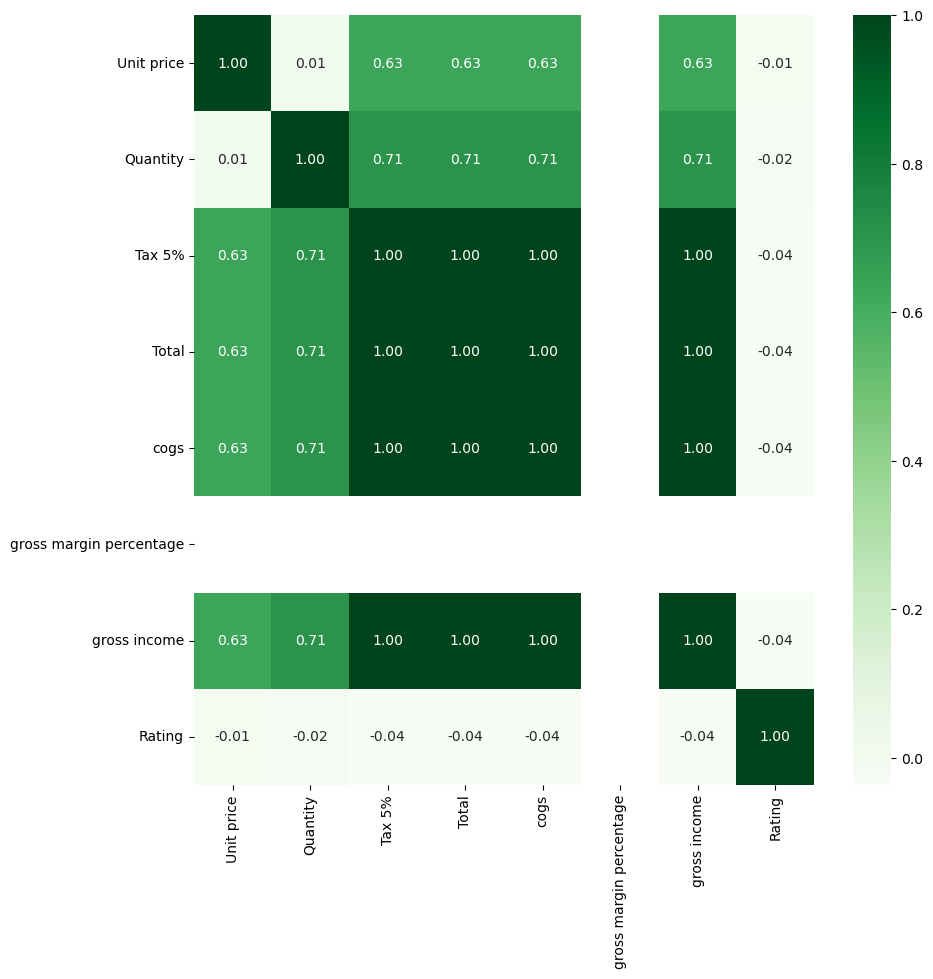

In [10]:
plt.figure(figsize=(10,10))
sns.heatmap(corr,annot=True,fmt='0.2f',cmap='Greens')

# Visualiazing **Customer Type** and their given **Rating**

<AxesSubplot:xlabel='Rating', ylabel='count'>

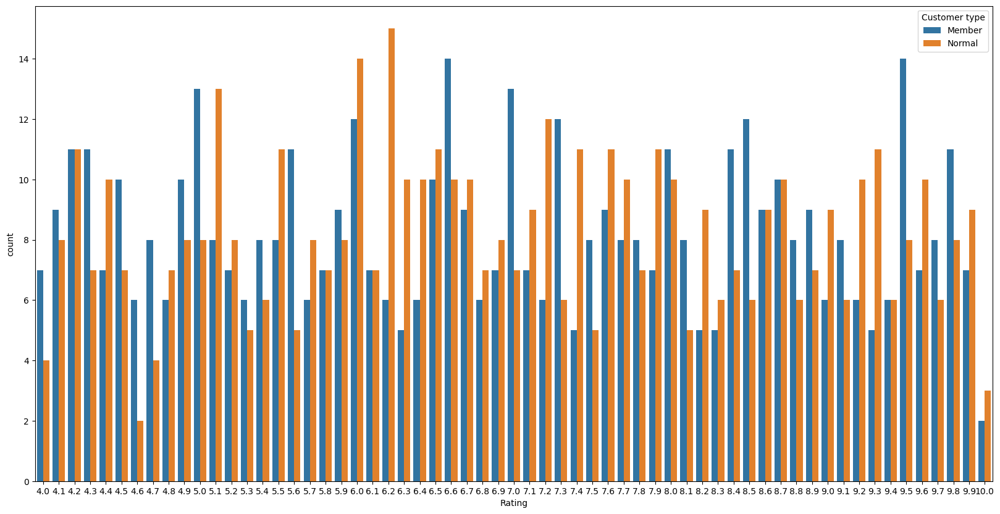

In [11]:
plt.figure(figsize=(20,10))
sns.countplot(data=sales,x='Rating',hue='Customer type')

<AxesSubplot:xlabel='Customer type', ylabel='Rating'>

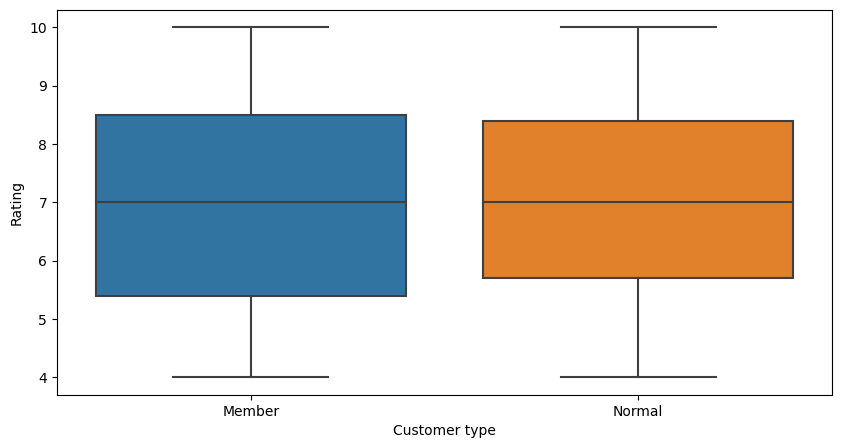

In [12]:
plt.figure(figsize=(10,5))
sns.boxplot(x='Customer type',y='Rating',data=sales)

> Insight
* **Normal** Customer type has given good rating as compare to **Member** Customer type

In [13]:
sales.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 17 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   Invoice ID               1000 non-null   object 
 1   Branch                   1000 non-null   object 
 2   City                     1000 non-null   object 
 3   Customer type            1000 non-null   object 
 4   Gender                   1000 non-null   object 
 5   Product line             1000 non-null   object 
 6   Unit price               1000 non-null   float64
 7   Quantity                 1000 non-null   int64  
 8   Tax 5%                   1000 non-null   float64
 9   Total                    1000 non-null   float64
 10  Date                     1000 non-null   object 
 11  Time                     1000 non-null   object 
 12  Payment                  1000 non-null   object 
 13  cogs                     1000 non-null   float64
 14  gross margin percentage  

> Categorical Feature
* Branch
* Product line
* Customer type
* Gender
* Date
* Time
* Payment
* gross margin percentage

# Customer type by Branch

Text(0.5, 1.0, 'Customer type by Branch')

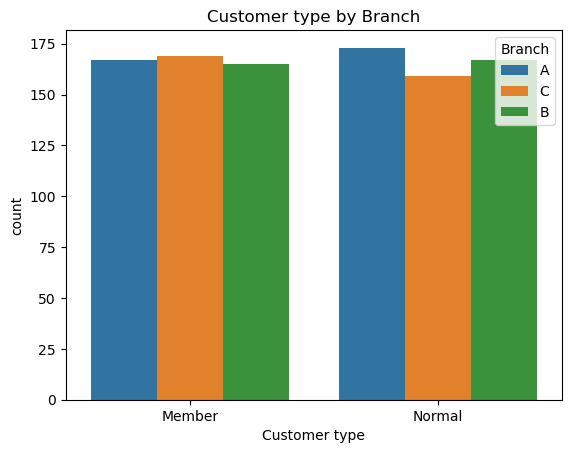

In [14]:
sns.countplot(x='Customer type',hue='Branch',data=sales)
plt.title('Customer type by Branch')

> Insight
* Customer type Member visits Branch A , B & C is **same**.
* Customer type Normal visits slightly **more at Branch A** as comapre to B & C.

# Payement by Branch

Text(0.5, 1.0, 'Payemnt By Branch')

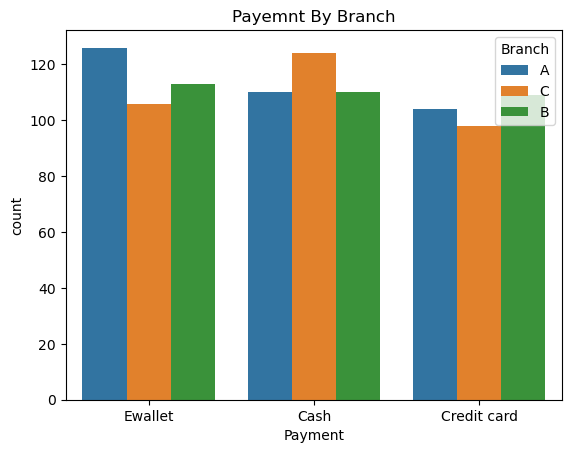

In [15]:
sns.countplot(data=sales,x='Payment',hue='Branch')
plt.title('Payemnt By Branch')

> Insight
* At branch **A** more pre-ferred way of payemnt is **Ewallet**.
* At branch **B** more pre-ferred way of payment is **Credit card**.
* At branch **C** more pre-ferred way of payment is **Cash Payment**.

# Product by Branch

Text(0.5, 1.0, 'Product by Branch')

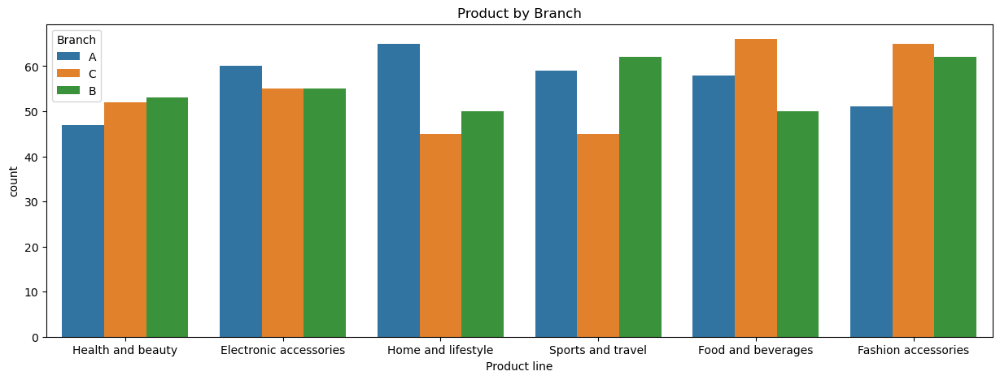

In [16]:
plt.figure(figsize=(15,5))
sns.countplot(x='Product line',hue='Branch',data=sales)
plt.title('Product by Branch')

> Insight
* More Health and beauty product at Branch **B**.
* More Electronic accessories product at Branch **A**.
* More Home and lifestyle product at Branch **A**.
* More Sports and travel product at Branch **B**.
* More Food and beverages product at Branch **C**.
* More Fashion accessories product at Branch **C**.

# Product line visualization

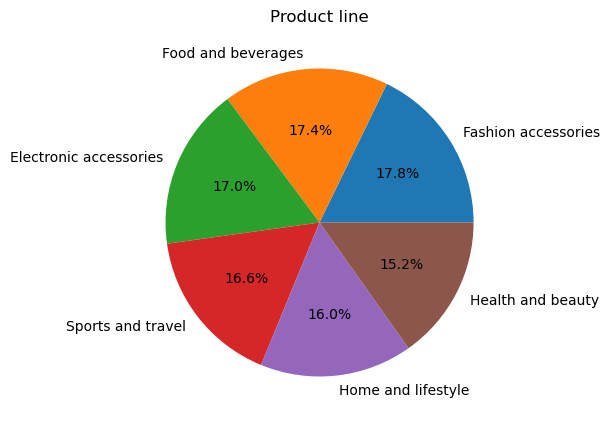

In [17]:
fig=plt.figure(figsize=(10,5))
ax=fig.add_subplot(111)
ax.set(title='Product line')
plt.pie(x=sales['Product line'].value_counts(),autopct='%.1f%%',labels=sales['Product line'].value_counts().index)
plt.show()

> Insight
* More product on **Fashion accessories**
* Less product on **Health and beauty**

# Date Feature

In [18]:
from datetime import datetime
sales['Date1']=[datetime.strptime(d,'%m/%d/%Y') for d in sales['Date']]
sales['Date2']=pd.to_datetime(sales['Date1'])
sales['Day']=sales.Date2.dt.day
sales['Month']=sales.Date2.dt.month
sales['Year']=sales.Date2.dt.year
sales['Weekday']=sales.Date2.dt.dayofweek
sales.head()

,Invoice ID,Branch,City,Customer type,Gender,Product line,Unit price,Quantity,Tax 5%,Total,...,cogs,gross margin percentage,gross income,Rating,Date1,Date2,Day,Month,Year,Weekday
0,750-67-8428,A,Yangon,Member,Female,Health and beauty,74.69,7,26.1415,548.9715,...,522.83,4.761905,26.1415,9.1,2019-01-05,2019-01-05,5,1,2019,5
1,226-31-3081,C,Naypyitaw,Normal,Female,Electronic accessories,15.28,5,3.8200,80.2200,...,76.40,4.761905,3.8200,9.6,2019-03-08,2019-03-08,8,3,2019,4
2,631-41-3108,A,Yangon,Normal,Male,Home and lifestyle,46.33,7,16.2155,340.5255,...,324.31,4.761905,16.2155,7.4,2019-03-03,2019-03-03,3,3,2019,6
3,123-19-1176,A,Yangon,Member,Male,Health and beauty,58.22,8,23.2880,489.0480,...,465.76,4.761905,23.2880,8.4,2019-01-27,2019-01-27,27,1,2019,6
4,373-73-7910,A,Yangon,Normal,Male,Sports and travel,86.31,7,30.2085,634.3785,...,604.17,4.761905,30.2085,5.3,2019-02-08,2019-02-08,8,2,2019,4


# Most busiest day in a month

<AxesSubplot:xlabel='Day', ylabel='count'>

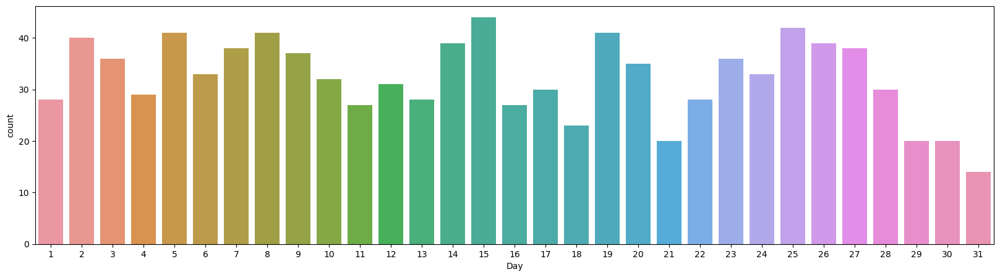

In [19]:
plt.figure(figsize=(20,5))
sns.countplot(x=sales['Day'],data=sales)

# Most busiest day in a Week

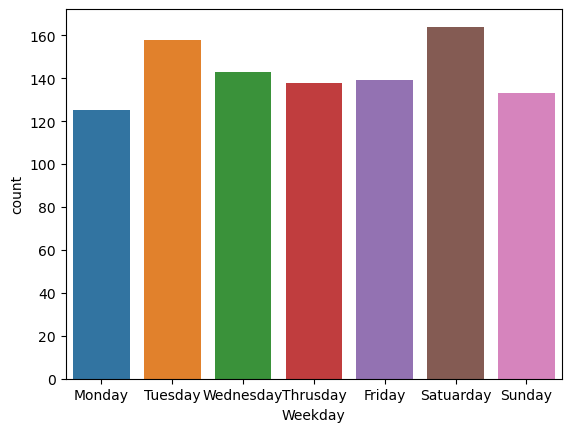

In [20]:
g=sns.countplot(x='Weekday',data=sales)
g.set_xticklabels(['Monday','Tuesday','Wednesday','Thrusday','Friday','Satuarday','Sunday'])
plt.show()

[Text(0, 0, 'Jan'), Text(1, 0, 'Feb'), Text(2, 0, 'Mar')]

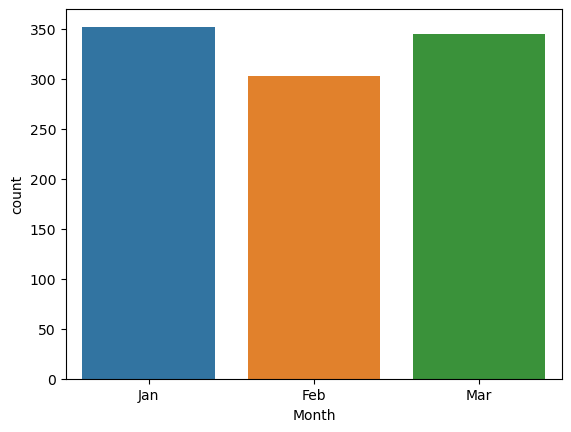

In [21]:
g=sns.countplot(x='Month',data=sales)
g.set_xticklabels(['Jan','Feb','Mar'])


In [22]:
sales['Time1']=pd.to_datetime(sales['Time'])
sales['Hour']=sales.Time1.dt.hour
sales.head()

,Invoice ID,Branch,City,Customer type,Gender,Product line,Unit price,Quantity,Tax 5%,Total,...,gross income,Rating,Date1,Date2,Day,Month,Year,Weekday,Time1,Hour
0,750-67-8428,A,Yangon,Member,Female,Health and beauty,74.69,7,26.1415,548.9715,...,26.1415,9.1,2019-01-05,2019-01-05,5,1,2019,5,2023-08-25 13:08:00,13
1,226-31-3081,C,Naypyitaw,Normal,Female,Electronic accessories,15.28,5,3.8200,80.2200,...,3.8200,9.6,2019-03-08,2019-03-08,8,3,2019,4,2023-08-25 10:29:00,10
2,631-41-3108,A,Yangon,Normal,Male,Home and lifestyle,46.33,7,16.2155,340.5255,...,16.2155,7.4,2019-03-03,2019-03-03,3,3,2019,6,2023-08-25 13:23:00,13
3,123-19-1176,A,Yangon,Member,Male,Health and beauty,58.22,8,23.2880,489.0480,...,23.2880,8.4,2019-01-27,2019-01-27,27,1,2019,6,2023-08-25 20:33:00,20
4,373-73-7910,A,Yangon,Normal,Male,Sports and travel,86.31,7,30.2085,634.3785,...,30.2085,5.3,2019-02-08,2019-02-08,8,2,2019,4,2023-08-25 10:37:00,10


<AxesSubplot:xlabel='Hour', ylabel='count'>

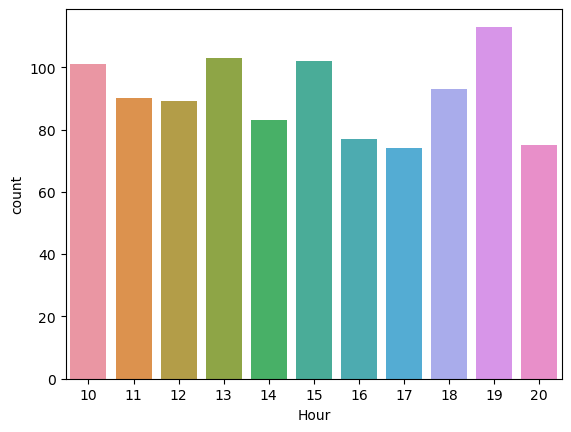

In [23]:
sns.countplot(x='Hour',data=sales)

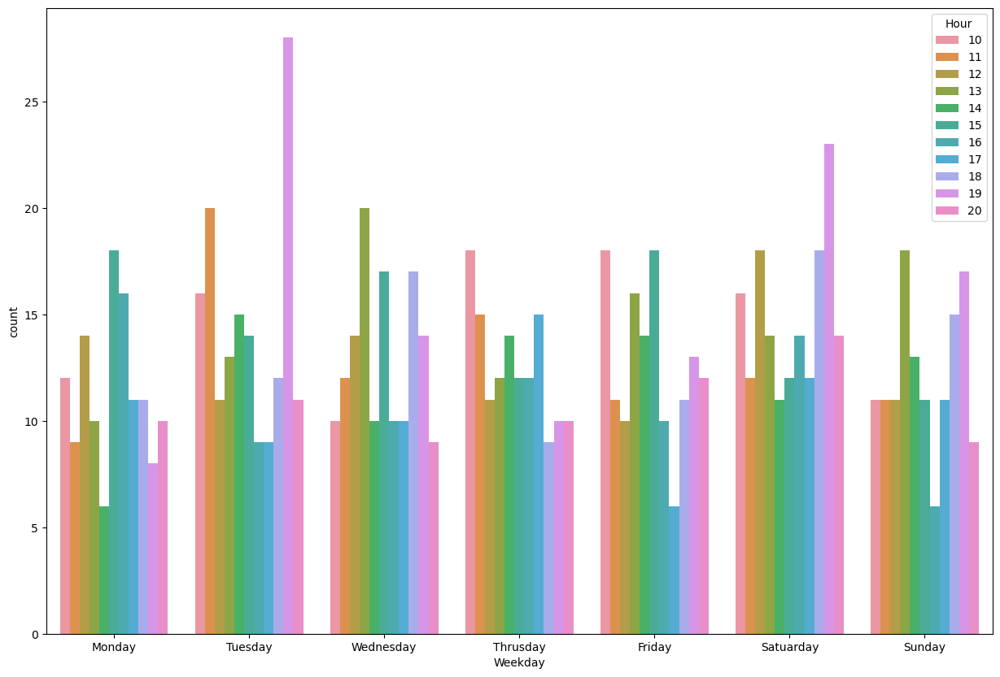

In [24]:
plt.figure(figsize=(15,10))
fig1=sns.countplot(x='Weekday',data=sales,hue='Hour')
fig1.set_xticklabels(['Monday','Tuesday','Wednesday','Thrusday','Friday','Satuarday','Sunday'])
plt.show()

# Categorical Data Mapping

> Categorical Feature
* Branch
* Product line
* Customer type
* Gender
* Date
* Time
* Payment
* gross margin percentage

In [25]:
# sales['Branch']=sales.Branch.map({'A':1,'B':2,'C':3})
# sales['Product line']=sales['Product line'].map({'Health and beauty':1,'Electronic accessories':2,'Home and lifestyle':3,'Sports and travel':4,'Food and beverages':5,'Fashion accessories':6})
# sales['Customer type']=sales['Customer type'].map({'Member':1,'Normal':2})
# sales['Gender']=sales.Gender.map({'Male':0,'Female':1})
# sales['Payment']=sales.Payment.map({'Ewallet':1,'Cash':2,'Credit card':3})

def categorical_transform_column(data,column):
    category=data[column].value_counts().index.to_list()
    map_cat={k:v for v,k in enumerate(category)}
    rev_map_cat={v:k for k,v in map_cat.items()}
    data[column]=data[column].map(map_cat)
    return data , map_cat , rev_map_cat

In [26]:
sales,branch,rev_branch=categorical_transform_column(sales,'Branch')
sales,product_line,rev_product_line=categorical_transform_column(sales,'Product line')
sales,customer_type,rev_customer_type=categorical_transform_column(sales,'Customer type')
sales,gender,rev_gender=categorical_transform_column(sales,'Gender')
sales,payment,rev_payment=categorical_transform_column(sales,'Payment')

In [27]:
branch

{'A': 0, 'B': 1, 'C': 2}

In [28]:
sales.head(5)

,Invoice ID,Branch,City,Customer type,Gender,Product line,Unit price,Quantity,Tax 5%,Total,...,gross income,Rating,Date1,Date2,Day,Month,Year,Weekday,Time1,Hour
0,750-67-8428,0,Yangon,0,0,5,74.69,7,26.1415,548.9715,...,26.1415,9.1,2019-01-05,2019-01-05,5,1,2019,5,2023-08-25 13:08:00,13
1,226-31-3081,2,Naypyitaw,1,0,2,15.28,5,3.8200,80.2200,...,3.8200,9.6,2019-03-08,2019-03-08,8,3,2019,4,2023-08-25 10:29:00,10
2,631-41-3108,0,Yangon,1,1,4,46.33,7,16.2155,340.5255,...,16.2155,7.4,2019-03-03,2019-03-03,3,3,2019,6,2023-08-25 13:23:00,13
3,123-19-1176,0,Yangon,0,1,5,58.22,8,23.2880,489.0480,...,23.2880,8.4,2019-01-27,2019-01-27,27,1,2019,6,2023-08-25 20:33:00,20
4,373-73-7910,0,Yangon,1,1,3,86.31,7,30.2085,634.3785,...,30.2085,5.3,2019-02-08,2019-02-08,8,2,2019,4,2023-08-25 10:37:00,10


In [29]:
sales.describe()

,Branch,Customer type,Gender,Product line,Unit price,Quantity,Tax 5%,Total,Payment,cogs,gross margin percentage,gross income,Rating,Day,Month,Year,Weekday,Hour
count,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.00000,1000.000000,1000.000000,1000.00000,1000.000000,1000.000000,1000.0,1000.000000,1000.000000
mean,0.988000,0.499000,0.499000,2.412000,55.672130,5.510000,15.379369,322.966749,0.966000,307.58738,4.761905,15.379369,6.97270,15.256000,1.993000,2019.0,3.032000,14.910000
std,0.817633,0.500249,0.500249,1.700926,26.494628,2.923431,11.708825,245.885335,0.809629,234.17651,0.000000,11.708825,1.71858,8.693563,0.835254,0.0,1.973543,3.186857
min,0.000000,0.000000,0.000000,0.000000,10.080000,1.000000,0.508500,10.678500,0.000000,10.17000,4.761905,0.508500,4.00000,1.000000,1.000000,2019.0,0.000000,10.000000
25%,0.000000,0.000000,0.000000,1.000000,32.875000,3.000000,5.924875,124.422375,0.000000,118.49750,4.761905,5.924875,5.50000,8.000000,1.000000,2019.0,1.000000,12.000000
50%,1.000000,0.000000,0.000000,2.000000,55.230000,5.000000,12.088000,253.848000,1.000000,241.76000,4.761905,12.088000,7.00000,15.000000,2.000000,2019.0,3.000000,15.000000
75%,2.000000,1.000000,1.000000,4.000000,77.935000,8.000000,22.445250,471.350250,2.000000,448.90500,4.761905,22.445250,8.50000,23.000000,3.000000,2019.0,5.000000,18.000000
max,2.000000,1.000000,1.000000,5.000000,99.960000,10.000000,49.650000,1042.650000,2.000000,993.00000,4.761905,49.650000,10.00000,31.000000,3.000000,2019.0,6.000000,20.000000


<AxesSubplot:>

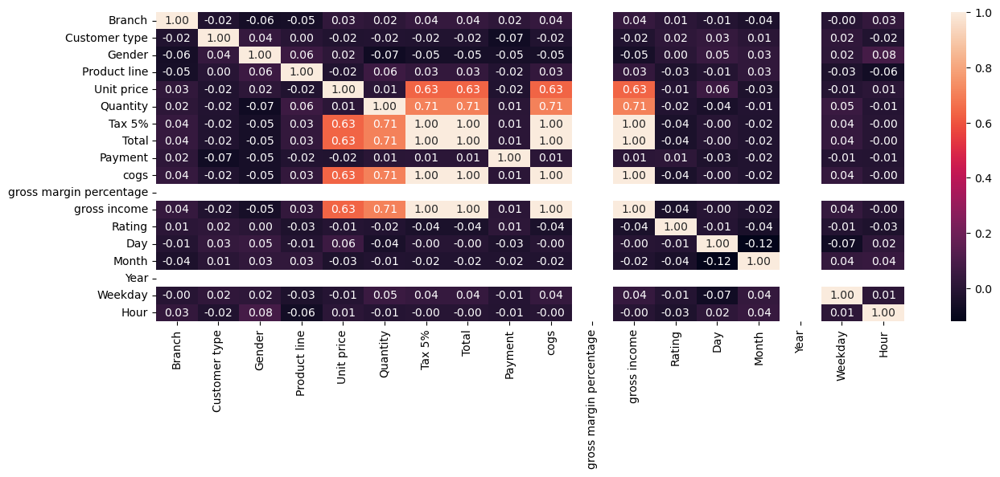

In [30]:
corr=sales.corr()
plt.figure(figsize=(15,5))
sns.heatmap(corr,annot=True,fmt='0.2f')

In [31]:
sales.profile_report(title='EDA Summary',progress_bar=False)

# Map the value to back as original it was. And converted to Categorical value.

In [32]:
sales['Branch']=pd.Categorical(sales.Branch.map({1:'A',2:'B',3:'C'}))
sales['Product line']=pd.Categorical(sales['Product line'].map({1:'Health and beauty',2:'Electronic accessories',3:'Home and lifestyle',4:'Sports and travel',5:'Food and beverages',6:'Fashion accessories'}))
sales['Customer type']=pd.Categorical(sales['Customer type'].map({1:'Member',2:'Normal'}))
sales['Gender']=pd.Categorical(sales.Gender.map({0:'Male',1:'Female'}))
sales['Payment']=pd.Categorical(sales.Payment.map({1:'Ewallet',2:'Cash',3:'Credit card'}))


In [33]:
sales['Branch'].dtypes
# sales['Gender'].dtypes
# sales['Product line'].dtypes

CategoricalDtype(categories=['A', 'B'], ordered=False)

In [34]:
sales.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 25 columns):
 #   Column                   Non-Null Count  Dtype         
---  ------                   --------------  -----         
 0   Invoice ID               1000 non-null   object        
 1   Branch                   660 non-null    category      
 2   City                     1000 non-null   object        
 3   Customer type            499 non-null    category      
 4   Gender                   1000 non-null   category      
 5   Product line             822 non-null    category      
 6   Unit price               1000 non-null   float64       
 7   Quantity                 1000 non-null   int64         
 8   Tax 5%                   1000 non-null   float64       
 9   Total                    1000 non-null   float64       
 10  Date                     1000 non-null   object        
 11  Time                     1000 non-null   object        
 12  Payment                  655 non-nu

In [35]:
sales.head()

,Invoice ID,Branch,City,Customer type,Gender,Product line,Unit price,Quantity,Tax 5%,Total,...,gross income,Rating,Date1,Date2,Day,Month,Year,Weekday,Time1,Hour
0,750-67-8428,NaN,Yangon,NaN,Male,Food and beverages,74.69,7,26.1415,548.9715,...,26.1415,9.1,2019-01-05,2019-01-05,5,1,2019,5,2023-08-25 13:08:00,13
1,226-31-3081,B,Naypyitaw,Member,Male,Electronic accessories,15.28,5,3.8200,80.2200,...,3.8200,9.6,2019-03-08,2019-03-08,8,3,2019,4,2023-08-25 10:29:00,10
2,631-41-3108,NaN,Yangon,Member,Female,Sports and travel,46.33,7,16.2155,340.5255,...,16.2155,7.4,2019-03-03,2019-03-03,3,3,2019,6,2023-08-25 13:23:00,13
3,123-19-1176,NaN,Yangon,NaN,Female,Food and beverages,58.22,8,23.2880,489.0480,...,23.2880,8.4,2019-01-27,2019-01-27,27,1,2019,6,2023-08-25 20:33:00,20
4,373-73-7910,NaN,Yangon,Member,Female,Home and lifestyle,86.31,7,30.2085,634.3785,...,30.2085,5.3,2019-02-08,2019-02-08,8,2,2019,4,2023-08-25 10:37:00,10


* Categorical mapping using **Data Analysis+Regression+Classification** notebook. --Done
* Graph visualization using matplotlib pie grabh using **Visualization IPL 2008 to 2020_Am** notebook. --Done
* Find busiest day in a week and every day busiest time of customer visit using datetime implementation usinng **Practices Estes Park Weather EDA_Am** notebook.--Done
